In [2]:
from pygel3d import hmesh, jupyter_display as jd, gl_display as gl, graph
import numpy as np
import math
from commons.utils import *
from commons.display import *
from commons.medial_axis import *
from random import random
from scipy.spatial import KDTree
from medial_axis_processing.smoothing import *
from medial_axis_processing import unfolding, inverse_apply
from medial_axis_loader import from_qmat, from_dpc, from_coverage_axis, from_medial_sheet

%load_ext autoreload
%autoreload 2

## Transformation mapping

In [137]:
def hexagon_vertices(radius=1):
    # Angles for each vertex of the hexagon
    angles = np.linspace(0, 2 * np.pi, 7)[:-1]  # 7 points with the last one being equal to the first one
    # Calculate the x and y coordinates
    x_coords = radius * np.cos(angles)
    y_coords = radius * np.sin(angles)
    # z coordinates are zero since it's in the z-plane
    z_coords = np.zeros_like(x_coords)
    
    # Stack the coordinates together
    vertices = np.stack((x_coords, y_coords, z_coords), axis=-1)
    vertices = np.vstack((np.array([[0, 0, 0]]), vertices))

    return vertices

vertices = hexagon_vertices()

faces = [
    [0, 1, 2],
    [0, 2, 3],
    [0, 3, 4],
    [0, 4, 5],
    [0, 5, 6],
    [0, 6, 1]
]

In [138]:
m = hmesh.Manifold.from_triangles(vertices, faces)

In [144]:
def rectangular_plane(N):
    x = np.linspace(-1, 1, N)
    y = np.linspace(-1, 1, N)
    xv, yv = np.meshgrid(x, y)
    zv = np.ones_like(xv)  # z = 1 for the plane
    vertices = np.stack((xv, yv, zv), axis=-1).reshape(-1, 3)
    faces = []
    for i in range(N - 1):
        for j in range(N - 1):
            idx = i * N + j
            faces.append([idx, idx + 1, idx + N])
            faces.append([idx + 1, idx + N + 1, idx + N])
    return vertices, faces

v, f = rectangular_plane(25)
surf = hmesh.Manifold.from_triangles(v, f)

In [145]:
show_indices = [0, 2024, 88, 1980, 1012, 44, 990, 1034, 2002, 506, 528, 1496, 1518]

In [195]:
ma = from_medial_sheet.load(surf, m)
# display_inner_projections(ma, indices=show_indices, save_path="step1")

Chosen minimum gamma: 50


In [196]:
vertices[1:,2] = 0.3
# ma.sheet.positions()[:] = vertices
# ma.inner_points[~ma.curve_indices] = vertices[ma.inner_to_sheet_index[~ma.curve_indices]]
# ma.graph.positions()[~ma.curve_indices] = vertices[ma.inner_to_sheet_index[~ma.curve_indices]]

inverse_apply.inverse_apply_sheet_v3(ma, vertices)

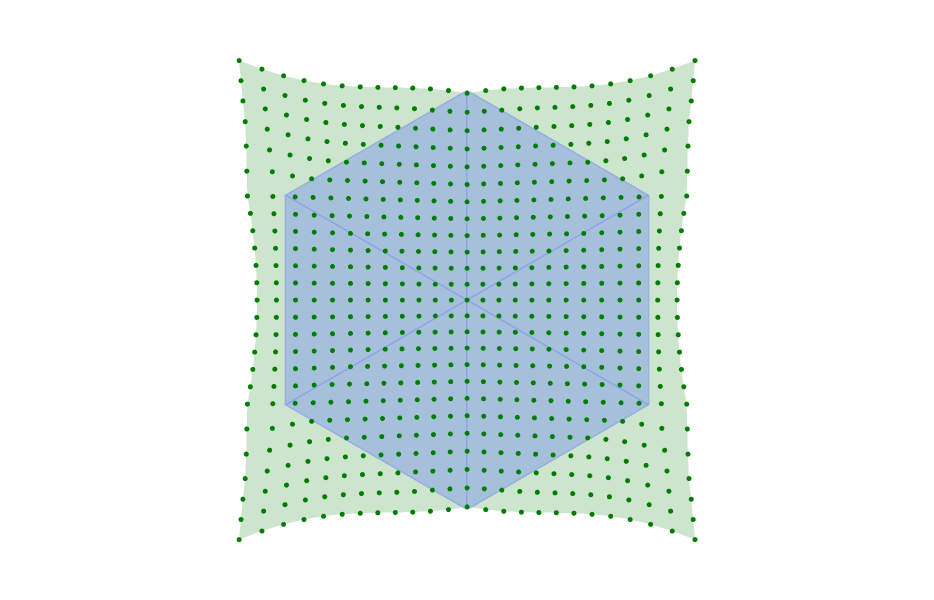

In [197]:
display_inner_projections(ma, save_path="smooth_frame")

## Unfolding pipeline

In [13]:
coin = hmesh.load("data/input/x19_voxelized.off")
# medial_sheet = hmesh.load("data/input/x19_voxelized_medial_sheet.obj") # data/input/x19_voxelized_medial_sheet.obj
hmesh.quadric_simplify(coin, 0.1)
coin.cleanup()
medial_sheet = hmesh.load("tmp.obj")

medial_axis = from_medial_sheet.load(coin, medial_sheet)

Chosen minimum gamma: 50


In [14]:
# coin = hmesh.load("data/input/x19_voxelized.off")

# medial_axis = from_qmat.load(coin, "data/vindelev/x19_voxelized.ma___v_200___e_555___f_355.ma")

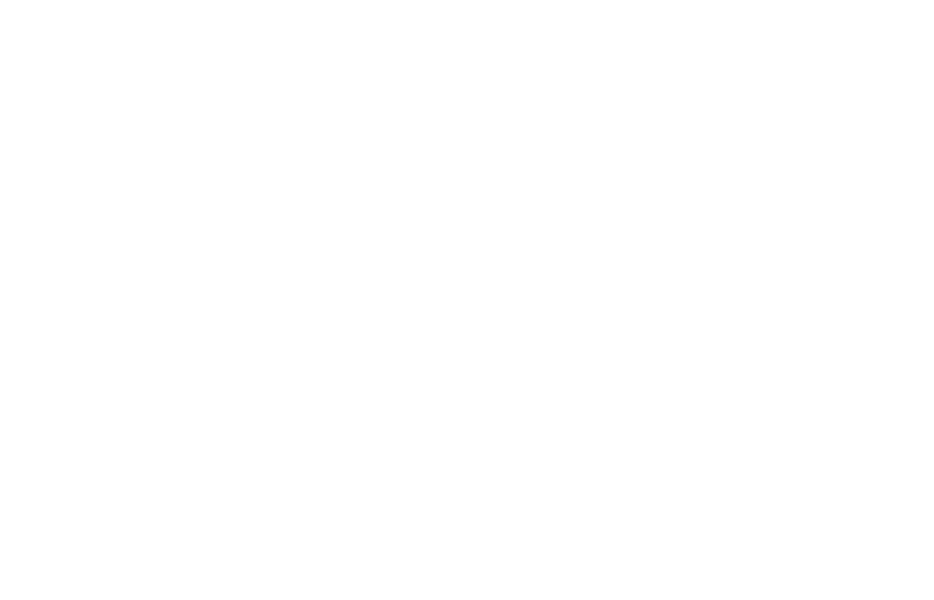

In [15]:
display_medial_mesh(medial_axis)

In [16]:
unfolded_pos = unfolding.get_unfolded_medial_axis_positions(medial_axis)

In [17]:
inverse_apply.inverse_apply_sheet_v3(medial_axis, unfolded_pos)

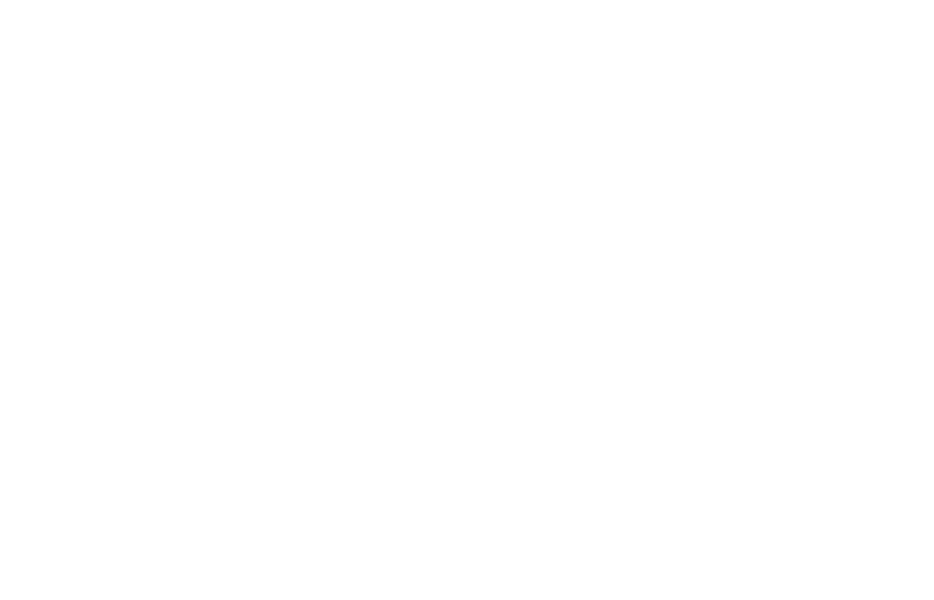

In [18]:
display_mesh(medial_axis.surface)

In [19]:
hmesh.obj_save("voxelized_unfolded.obj", medial_axis.surface)

## RF tuning pipeline

In [2]:
def rectangular_plane(N, z=1):
    x = np.linspace(-1, 1, N)
    y = np.linspace(-1, 1, N)
    xv, yv = np.meshgrid(x, y)
    zv = np.ones_like(xv)
    vertices = np.stack((xv, yv, zv), axis=-1).reshape(-1, 3)
    vertices[:,2] = z
    
    faces = []
    for i in range(N - 1):
        for j in range(N - 1):
            idx = i * N + j
            faces.append([idx, idx + 1, idx + N])
            faces.append([idx + 1, idx + N + 1, idx + N])
            
    center_vertices_indices = []
    radius = 0.5  # You can adjust this radius value as needed
    for idx, vertex in enumerate(vertices):
        if np.sqrt(vertex[0]**2 + vertex[1]**2) < radius:
            center_vertices_indices.append(idx)
    
    return vertices, faces, center_vertices_indices

In [37]:
v, f, center = rectangular_plane(25, z=0.5)
surf = hmesh.Manifold.from_triangles(v, f)

In [38]:
v, f, _ = rectangular_plane(5, z=0)
medial_sheet = hmesh.Manifold.from_triangles(v, f)

In [39]:
ma = from_medial_sheet.load(surf, medial_sheet)

Chosen minimum gamma: 50


In [43]:
display_inner_projections(ma, save_path="rf_orig")

In [22]:
intensities = np.ones(len(ma.outer_points))
intensities[center] = 1.5

In [23]:
pos = ma.surface.positions()
new_pos = np.copy(pos)

for i, outer in enumerate(ma.outer_points):
    inner_projection = ma.inner_projections[i]
    diff = outer - inner_projection
    diff_len = np.linalg.norm(diff)
    diff /= diff_len
    
    new_pos[i] = inner_projection + (diff * (intensities[i] * diff_len))

In [24]:
ma.outer_points[:] = new_pos
ma.surface.positions()[:] = new_pos

In [31]:
display_inner_projections(ma, save_path="rf_processed")

In [26]:
hmesh.obj_save("circle.obj", ma.surface)

## Smoothing pipeline

In [87]:
blue = "#4d6aff"
green = "#529323"
red = "#bf282d"

2274937747


/var/folders/f9/kx3v6ltd2g1071tf80bs2jf00000gn/T/ipykernel_77337/3964528100.py:24: RankWarning:

Polyfit may be poorly conditioned



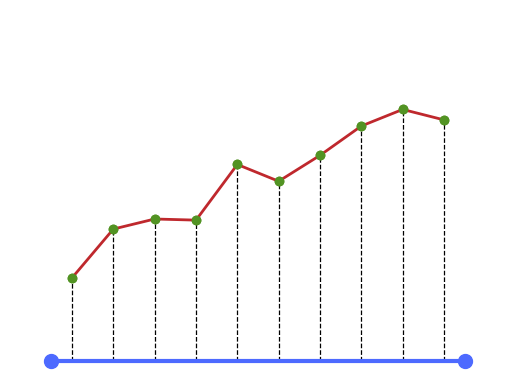

In [127]:
import matplotlib.pyplot as plt
import numpy as np

seed = np.random.randint(0, 2**32 - 1)
print(seed)

seed = 3091284821

np.random.seed(seed)

# Generate random x values
x = np.linspace(0.5, 9.5, 10)


# Define the slope and intercept of the approximated growing line
slope = 0.1
intercept = 0.5

# Generate y values along the growing line with added noise
noise = np.random.normal(0, 0.1, x.size)
y = slope * x + intercept + noise

# Fit a line to the noisy points using least squares
coefficients = np.polyfit(x, y, 10)
line_fit = np.poly1d(coefficients)

y_fitted = line_fit(x)


# Create a figure and axis
fig, ax = plt.subplots()

# Plot the horizontal line at y=0 with endpoints
plt.plot([0, 10], [0, 0], color=blue, linewidth=3, marker='o', markerfacecolor=blue, zorder=1, markersize=10)

# Plot the noisy points
plt.scatter(x, y, color=green, zorder=2)

# Add projection lines from each point to the y=0 line
for xi, yi in zip(x, y_fitted):
    plt.plot([xi, xi], [0, yi], color='black', linestyle='--', linewidth=0.9, zorder=0)

plt.plot(x, y_fitted, color=red, linewidth=2)
plt.scatter(x, y_fitted, color=green, zorder=5)

# Remove all axes
ax.axis('off')
# Display the plot
# plt.savefig("smoothing3")
plt.xlim((-1,11))
plt.ylim((-0.1,2))
plt.show()

## MAT methods

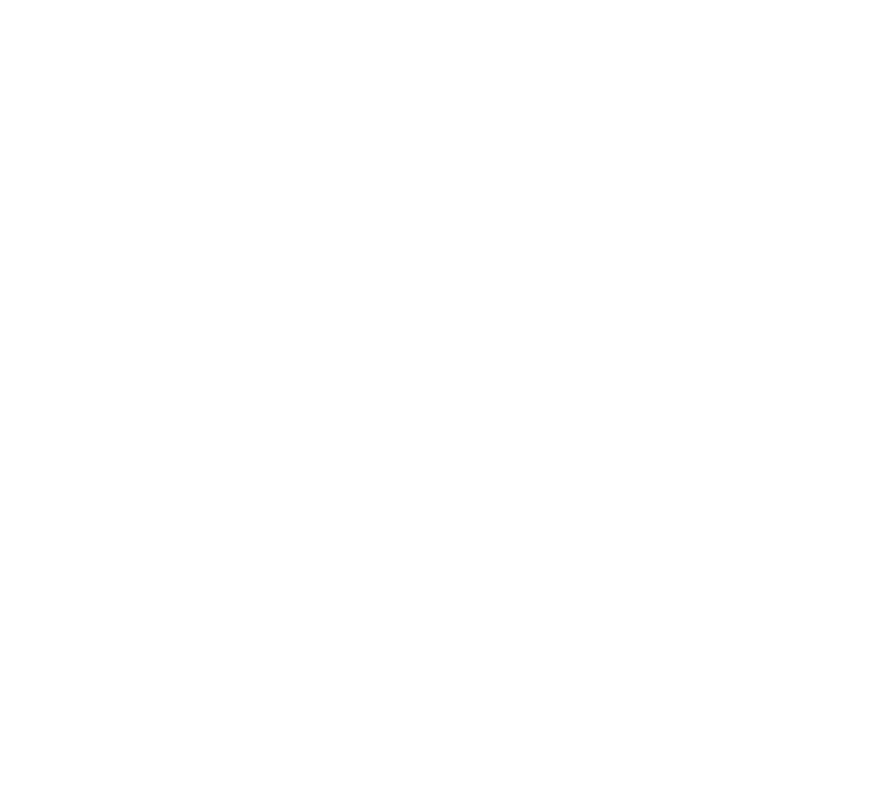

In [39]:
input_mesh = hmesh.load("data/input/hand.obj")
dpc_ma = from_dpc.load(input_mesh, "data/dpc/hand_noisy.dpc")

display_medial_mesh(dpc_ma) #, save_path="results/report/hand_dpc")

Chosen minimum gamma: 5


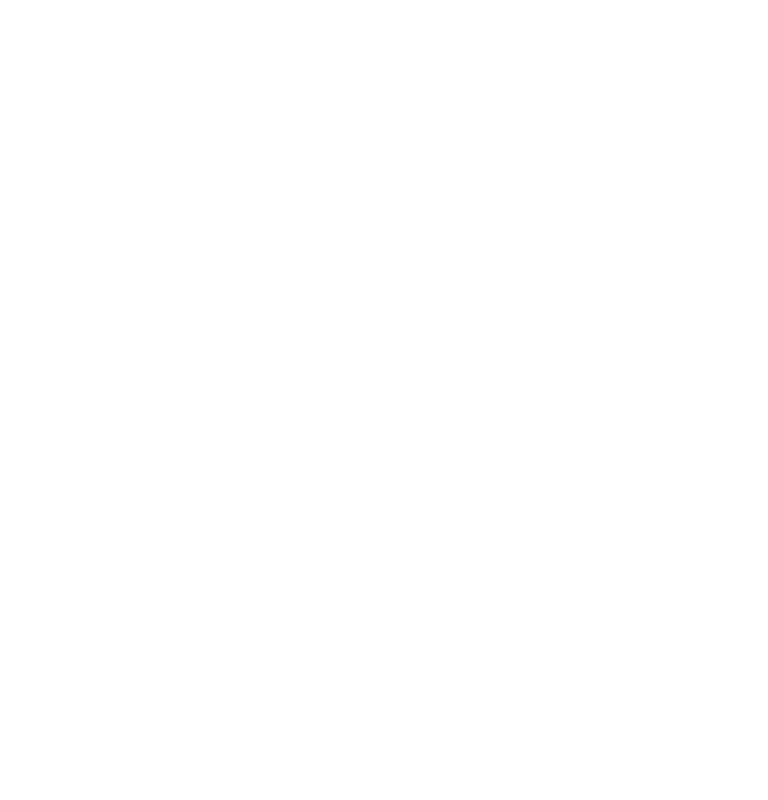

In [37]:
qmat_ma = from_qmat.load(input_mesh, "data/qmat/hand_noisy.ma___v_100___e_191___f_93.ma")
display_medial_mesh(qmat_ma) #, save_path="results/report/hand_qmat")

In [52]:
ca_ma = from_coverage_axis.load(input_mesh, "data/coverage_axis/sim_MA___v_74___e_125___f_52.obj")
display_medial_mesh(ca_ma) #, save_path="results/report/hand_ca_d001")

Chosen minimum gamma: 0.024000000000000014


Chosen minimum gamma: 0.03100000000000002


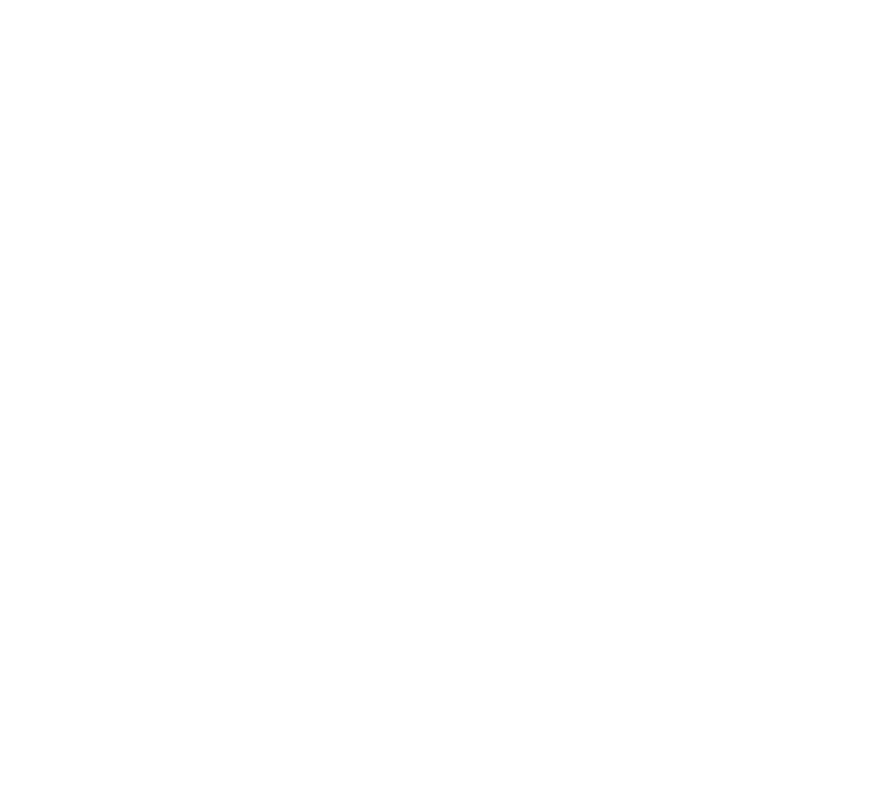

In [28]:
input_mesh = hmesh.load("data/input/hand.obj")
dpc_ma = from_coverage_axis.load(input_mesh, "data/coverage_axis/hand_d0015.obj")

display_medial_mesh(dpc_ma, save_path="results/report/hand_ca_d0015")

## Vindelev pipeline

In [3]:
input_mesh = hmesh.load("data/input/x19_voxelized.obj")
medial_sheet = hmesh.load("data/input/x19_voxelized_medial_sheet.obj")

In [5]:
medial_axis = from_medial_sheet.load(input_mesh, medial_sheet)

Chosen minimum gamma: 60


In [7]:
display_medial_mesh(medial_axis)

In [8]:
unfolded_sheet = unfolding.get_unfolded_sheet_positions(medial_axis)

In [9]:
inverse_apply.inverse_apply_sheet_v3(medial_axis, unfolded_sheet)

In [10]:
display_medial_mesh(medial_axis)